load packages

In [1]:
using JuMIT
using Statistics
using Plots
pyplot()

Plots.PyPlotBackend()

create simple (almost) homogeneous acoustic model

In [2]:
model=J.Gallery.Seismic(:acou_homo1)
J.Models.Seismic_addon!(model, randn_perc=0.01)

JuMIT.Models.Seismic([1500.0, 3500.0], [1.0, 1.0], [1500.0, 3500.0], [-0.00015283 -2.45103e-5 … 0.000195026 -2.09815e-5; 9.91605e-5 -2.27439e-5 … 2.46349e-5 1.68633e-5; … ; 6.51553e-5 1.01208e-5 … 3.74161e-6 3.36903e-5; 0.00016243 -0.000109525 … 9.12624e-5 6.13622e-5], [-5.37103e-5 -8.03384e-5 … 0.000167778 3.79017e-5; -2.40331e-5 -0.000129761 … -0.000107975 -4.27309e-5; … ; 3.97084e-5 -1.36425e-6 … 8.75965e-5 -8.51149e-5; 7.21351e-5 -3.52705e-5 … 0.000192821 -0.000181425], [1.36354e-5 0.000129949 … 6.78794e-5 -0.000114154; -6.6324e-5 5.41676e-6 … 0.000200412 -0.000181637; … ; -1.04766e-5 -2.26154e-5 … -7.96205e-5 -9.77054e-5; 4.82282e-6 -5.15189e-6 … 0.000188161 8.96503e-5], StepRangeLen{Float64,Base.TwicePrecision{Float64},Base.TwicePrecision{Float64}}[-1000.0:10.0:1000.0, -1000.0:10.0:1000.0], [3.375e9, 4.2875e10], [1500.0, 3500.0], [2.33236e-11, 2.96296e-10], [0.000285714, 0.000666667], [0.000285714, 0.000666667], JuMIT.Models.Seismic_ref{Float64}(2500.0, 1.0, 2500.0, 2.3125e10, 25

a simple acquisition geometry

In [3]:
acqgeom = JuMIT.Gallery.Geom(model.mgrid,:xwell);

	Acquisition Geometry:	xwell
	> number of supersources:	2
	> sources per supersource:	min	1	max	1
	> receivers per supersource:	min	2	max	2
	> number of unique positions of:	sources	2	receivers	2


plot the model and source, receivers

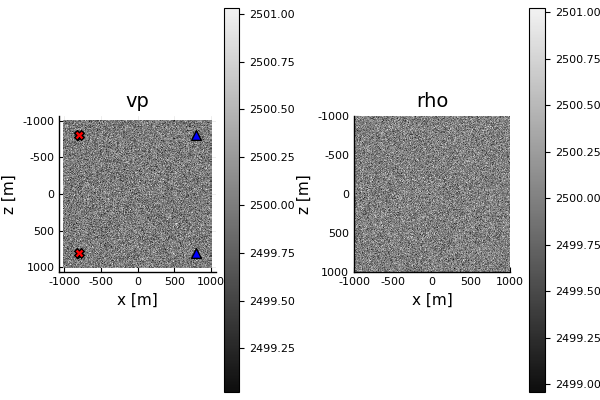

In [4]:
p1=JP.seismic(model)
JP.geom!(acqgeom)
plot(p1)

generate time grid

In [5]:
tgrid = range(0.0,stop=2.0,length=1000)

0.0:0.002002002002002002:2.0

Ricker wavelet

In [6]:
wav = JuMIT.Utils.Wavelets.ricker(10.0, tgrid, tpeak=0.25,);

distribute the same source wavelet to all the supsersources

In [7]:
acqsrc=JuMIT.Acquisition.Src_fixed(acqgeom.nss,1,[:P],wav,tgrid);

create `Fdtd.Param` object to prepare forward modelling
* npw corresponds to the number of independently propagating wavefields (1 in most cases)

In [8]:
pa=JuMIT.Fdtd.Param(npw=1,model=model,
	acqgeom=[acqgeom], acqsrc=[acqsrc],
	sflags=[2], rflags=[1],
	tgridmod=tgrid, verbose=true);

┌ Info: spatial sampling (1.00e+01) can be as high as 1.02e+01
└ @ JuMIT.Fdtd /math/home/pawbz/.julia/dev/JuMIT/src/Fdtd/Fdtd.jl:1001
┌ Warning: decrease time sampling (2.00e-03) below 1.43e-03
└ @ JuMIT.Fdtd /math/home/pawbz/.julia/dev/JuMIT/src/Fdtd/Fdtd.jl:1012


Once the `Param` object is created, do the modelling "without any memory allocations" using `mod!`

In [9]:
@time JuMIT.Fdtd.mod!(pa);

	modeling supershot 1/2 100%|███████████████████████████| Time: 0:00:02
	modeling supershot 2/2 100%|███████████████████████████| Time: 0:00:02
 ──────────────────────────────────────────────────────────────────────────
                                   Time                   Allocations      
                           ──────────────────────   ───────────────────────
     Tot / % measured:          4.65s / 100%             233KiB / 98.2%    

 Section           ncalls     time   %tot     avg     alloc   %tot      avg
 ──────────────────────────────────────────────────────────────────────────
 mod_per_proc!          1    4.65s   100%   4.65s    182KiB  79.4%   182KiB
 initialize!            1   2.53ms  0.05%  2.53ms   36.8KiB  16.1%  36.8KiB
 record data            1    123μs  0.00%   123μs   8.31KiB  3.63%  8.31KiB
 stack_grads!           1   64.0μs  0.00%  64.0μs   2.05KiB  0.89%  2.05KiB
 update gradient        1    209ns  0.00%   209ns         -  0.00%        -
 ──────────────────

plot a record after modelling

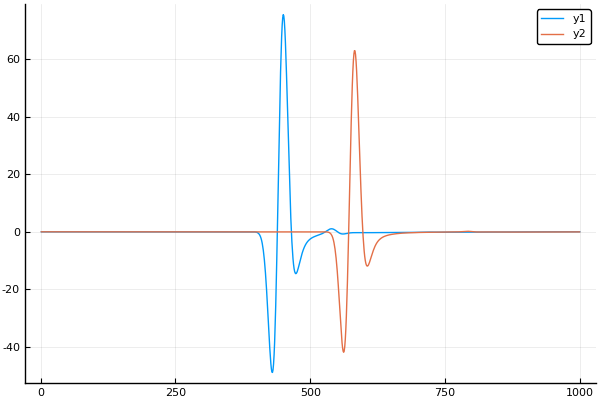

In [10]:
pdata=plot(pa.c.data[1].d[1,1])
plot(pdata)

create new seismic model

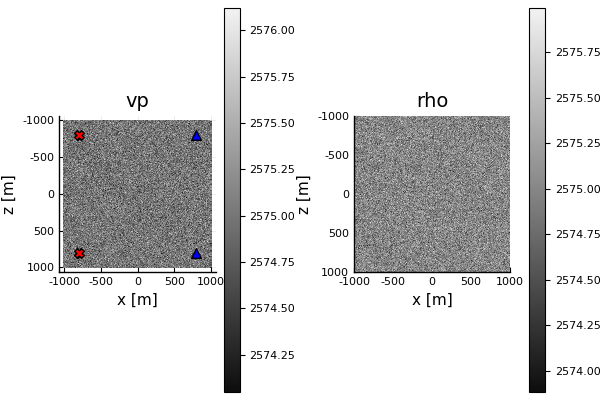

In [11]:
model_new=J.Gallery.Seismic(:acou_homo1) # prepare another model
J.Models.Seismic_addon!(model_new, randn_perc=0.01)
J.Models.Seismic_addon!(model_new, constant_pert=0.03) # perturb the model
p2=JP.seismic(model_new) # plot new model
JP.geom!(acqgeom)
plot(p2)

Now, we the change the model in the `Param` object without memory allocation
This routine can be used during FWI,
where medium parameters are itertively updated in the same `Fdtd.Param` object

In [12]:
J.Fdtd.update_model!(pa.c, model_new)

run modelling now and plot data again

In [13]:
@time JuMIT.Fdtd.mod!(pa);

	modeling supershot 1/2 100%|███████████████████████████| Time: 0:00:02
	modeling supershot 2/2 100%|███████████████████████████| Time: 0:00:02
 ──────────────────────────────────────────────────────────────────────────
                                   Time                   Allocations      
                           ──────────────────────   ───────────────────────
     Tot / % measured:          4.64s / 100%             233KiB / 98.2%    

 Section           ncalls     time   %tot     avg     alloc   %tot      avg
 ──────────────────────────────────────────────────────────────────────────
 mod_per_proc!          1    4.64s   100%   4.64s    182KiB  79.5%   182KiB
 initialize!            1   4.71ms  0.10%  4.71ms   36.7KiB  16.0%  36.7KiB
 record data            1    147μs  0.00%   147μs   8.19KiB  3.58%  8.19KiB
 stack_grads!           1   90.4μs  0.00%  90.4μs   2.05KiB  0.90%  2.05KiB
 update gradient        1    127ns  0.00%   127ns         -  0.00%        -
 ──────────────────

plot a record after modelling

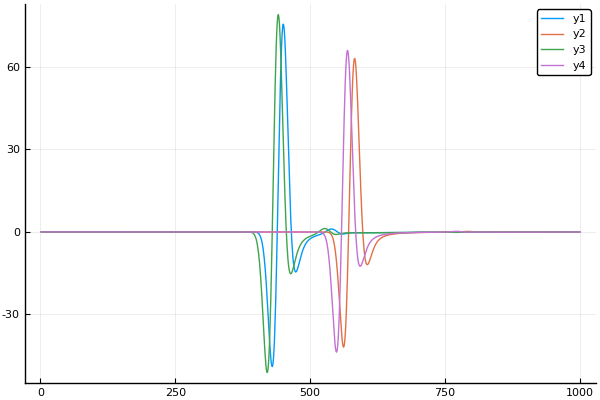

In [14]:
plot!(pdata, pa.c.data[1].d[1,1])
plot(pdata)

*This notebook was generated using [Literate.jl](https://github.com/fredrikekre/Literate.jl).*